Biblioteki

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import regex as re
import math

Wczytanie pliku z wynikami

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
path = '/content/drive/MyDrive/Colab Notebooks/wyniki_ankieta.xlsx'

In [ ]:
df = pd.read_excel(path)
df

,Numer wywiadu,Powód zakończenia,"Dzień dobry, nazywam się _user_ i jestem ankieterem GRUPY BADAWCZEJ DSC. NEW_LINE NEW_LINE Na zlecenie Instytutu Zagospodarowania Środowiska i Polityki Przestrzennej Wydziału Nauk Geograficznych Uniwersytetu Łódzkiego przeprowadzamy naukowe badanie ankietowe na temat mobilności codziennej osób starszych (w wieku 60+) mieszkających w małych miastach województwa łódzkiego. NEW_LINE NEW_LINE Jednocześnie pragniemy zapewnić, że ankieta jest anonimowa, a uzyskane informacje opracowane będą wyłącznie w formie zbiorczych zestawień statystycznych. NEW_LINE NEW_LINE Nasze badanie potrwa ok. 10 minut. a zadawane pytania dotyczyć będą Pana/i aktywności z ostatniego miesiąca tj. z miesiąca września. NEW_LINE NEW_LINE ANK: W przypadku, gdyby osoba ZADAŁA PYTANIE NT. POCHODZENIA / SPOSOBU PRZETWARZANIA DANYCH OSOBOWYCH PRZEZ GRUPĘ BADAWCZĄ DSC - proszę poinformować respondenta ŻE SZCZEGÓŁY PROJEKTU ORAZ REGULAMIN SĄ DOSTĘPNE NA STRONIE WWW.GRUPA-DSC.EU) NEW_LINE NEW_LINE S1. Czy zgadza się Pan/i na udział i czy możemy rozpocząć ankietę? NEW_LINE NEW_LINE","1. Do jakiego miasta w województwie łódzkim się dodzwoniłem/dodzwoniłam _FF_? NEW_LINE NEW_LINE ANK: Jeśli respondent wskazuje miasto (które jest na liście) to kontynuujemy ankietę zaznaczając odpowiednie miasto, jak nie, to kończymy. NEW_LINE NEW_LINE",Próba,2. Czy urodził/a się Pan/Pani w 1962 roku lub wcześniej?,M1. Płeć respondenta:,M2. Ile ma Pan/Pani lat?,M2A. A gdybym mógł/mogła wpisać Pana/Panią do jednej z grup wiekowych – to do którego przedziału wiekowego mogę Pana/Panią przypisać?,M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?,M3A. Ile z tych osób ma poniżej 6 lat?,M8. W jakim rodzaju budownictwa Pan/i mieszka?,M9. Czy w Pana/Pani gospodarstwie domowym (w którym Pan/Pani mieszka) jest samochód osobowy?,M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?,M10. Czy w Pana/Pani gospodarstwie domowym (w którym Pan/Pani mieszka) znajdują się sprawne rowery (nie uwzględniając rowerów dziecięcych)?,M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?,"M12. Proszę wybrać, który z przedziałów wartości dochodu netto (na rękę) na osobę najlepiej opisuje Pana/i gospodarstwo domowe.","M14. Proszę wybrać, jakie ma Pan/i ukończone wykształcenie",M15. Czy na dzień dzisiejszy posiada Pan/i uprawnienia do kierowania samochodem osobowym?,M16. Jakie było Pana/i podstawowe (przeciętnie zajmujące najwięcej czasu) zajęcie w ostatnich 7 dniach (jednokrotny wybór):,M16.1. Gdzie pracuje Pan/i?,M16.2 W jakim województwie?,M16.3 A w jakim powiecie lub mieście?,M16.3 W jakiej gminie?,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.1,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.2,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.3,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.4,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.5,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.6,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.7,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.8,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.9,3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.10,"4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca","4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pa

Pytania:
* 1. Do jakiego miasta w województwie łódzkim się dodzwoniłem/dodzwoniłam?
* 2. Czy urodził/a się Pan/Pani w 1962 roku lub wcześniej?
* M1. Płeć respondenta.
* M2. Ile ma Pan/Pani lat?
* M2A. A gdybym mógł/mogła wpisać Pana/Panią do jednej z grup wiekowych – to do którego przedziału wiekowego mogę Pana/Panią przypisać?
* M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?
* M3A. Ile z tych osób ma poniżej 6 lat?
* M8. W jakim rodzaju budownictwa Pan/i mieszka?
* M9. Czy w Pana/Pani gospodarstwie domowym (w którym Pan/Pani mieszka) jest samochód osobowy?
* M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?
* M10. Czy w Pana/Pani gospodarstwie domowym (w którym Pan/Pani mieszka) znajdują się sprawne rowery (nie uwzględniając rowerów dziecięcych)?
* M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?
* M12. Proszę wybrać, który z przedziałów wartości dochodu netto (na rękę) na osobę najlepiej opisuje Pana/i gospodarstwo domowe.
* M14. Proszę wybrać, jakie ma Pan/i ukończone wykształcenie.
* M15. Czy na dzień dzisiejszy posiada Pan/i uprawnienia do kierowania samochodem osobowym?
* M16. Jakie było Pana/i podstawowe (przeciętnie zajmujące najwięcej czasu) zajęcie w ostatnich 7 dniach (jednokrotny wybór)?
* M16.1. Gdzie pracuje Pan/i?
* M16.2 W jakim województwie?
* M16.3 A w jakim powiecie lub mieście?
* M16.4 W jakiej gminie?
* 3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu? (praca, zakupy, sprawy urzędowe, kościół, oweidziny, lekarz, rozrywka/kultura, fryzjer/kosmetyczka, szkolenia/warsztaty, dom opieki) 
* 4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką)? (praca, zakupy, sprawy urzędowe, kościół, oweidziny, lekarz, rozrywka/kultura, fryzjer/kosmetyczka, szkolenia/warsztaty, dom opieki) 
* 5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu)? (praca, zakupy, sprawy urzędowe, kościół, oweidziny, lekarz, rozrywka/kultura, fryzjer/kosmetyczka, szkolenia/warsztaty, dom opieki) 
* 6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu)? (praca, zakupy, sprawy urzędowe, kościół, oweidziny, lekarz, rozrywka/kultura, fryzjer/kosmetyczka, szkolenia/warsztaty, dom opieki) 
* 7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)? (praca, zakupy, sprawy urzędowe, kościół, oweidziny, lekarz, rozrywka/kultura, fryzjer/kosmetyczka, szkolenia/warsztaty, dom opieki) 
* 8. Czy jest coś, co ogranicza Pana/Pani mobilność (możliwość swobodnego przemieszczania się  podróżowania)? 
* 8.1 Jeśli tak, to co (można zaznaczyć więcej niż jedną odpowiedź)?
* 11. Jaki jest powód niewykorzystywania przez Pana/Panią transportu publicznego w codziennych podróżach?
* 12. Jak Pan/Pani ocenia transport zbiorowy w swoim mieście w skali od 0 do 5 (0 – nie mam zdania, 1 – bardzo źle, 2 – źle, 3 – przeciętnie, 4 –dobrze, 5 – bardzo dobrze)?


Tworzymy tabelę ze zliczoną ilością odpowiedzi dla każdego pytania i sprawdzamy, które pytania mają za małą ilość odpowiedzi. Usuwamy również pytania ze zbyt dużą liczbą unikalnych odpowiedzi oraz te, które nie wnoszą nic do dalszej analizy.

In [ ]:
df = df.drop(['Dzień dobry, nazywam się _user_ i jestem ankieterem GRUPY BADAWCZEJ DSC. NEW_LINE NEW_LINE Na zlecenie Instytutu Zagospodarowania Środowiska i Polityki Przestrzennej Wydziału Nauk Geograficznych Uniwersytetu Łódzkiego przeprowadzamy naukowe badanie ankietowe na temat mobilności codziennej osób starszych (w wieku 60+) mieszkających w małych miastach województwa łódzkiego. NEW_LINE NEW_LINE Jednocześnie pragniemy zapewnić, że ankieta jest anonimowa, a uzyskane informacje opracowane będą wyłącznie w formie zbiorczych zestawień statystycznych. NEW_LINE NEW_LINE Nasze badanie potrwa ok. 10 minut. a zadawane pytania dotyczyć będą Pana/i aktywności z ostatniego miesiąca tj. z miesiąca września. NEW_LINE NEW_LINE ANK: W przypadku, gdyby osoba ZADAŁA PYTANIE NT. POCHODZENIA / SPOSOBU PRZETWARZANIA DANYCH OSOBOWYCH PRZEZ GRUPĘ BADAWCZĄ DSC - proszę poinformować respondenta ŻE SZCZEGÓŁY PROJEKTU ORAZ REGULAMIN SĄ DOSTĘPNE NA STRONIE WWW.GRUPA-DSC.EU) NEW_LINE NEW_LINE S1. Czy zgadza się Pan/i na udział i czy możemy rozpocząć ankietę? NEW_LINE NEW_LINE'], axis = 1)
df = df.drop(['Powód zakończenia'], axis = 1)

In [ ]:
df['1. Do jakiego miasta w województwie łódzkim się dodzwoniłem/dodzwoniłam _FF_? NEW_LINE NEW_LINE ANK: Jeśli respondent wskazuje miasto (które jest na liście) to kontynuujemy ankietę zaznaczając odpowiednie miasto, jak nie, to kończymy. NEW_LINE NEW_LINE'].unique()

array(['Łask', 'Wieruszów', 'Ozorków', 'Pajęczno', 'Rawa Mazowiecka',
       'Łęczyca', 'Poddębice', 'Brzeziny', 'Działoszyn', 'Głowno',
       'Szadek', 'Przedbórz', 'Uniejów', 'Konstantynów Łódzki', 'Tuszyn',
       'Błaszki', 'Koluszki', 'Krośniewice', 'Żychlin', 'Sulejów',
       'Stryków', 'Kamieńsk', 'Zelów', 'Warta', 'Biała Rawska', 'Wolbórz',
       'Złoczew', 'Lututów', 'Drzewica', 'Piątek', 'Rzgów'], dtype=object)

In [ ]:
df = df.drop(['1. Do jakiego miasta w województwie łódzkim się dodzwoniłem/dodzwoniłam _FF_? NEW_LINE NEW_LINE ANK: Jeśli respondent wskazuje miasto (które jest na liście) to kontynuujemy ankietę zaznaczając odpowiednie miasto, jak nie, to kończymy. NEW_LINE NEW_LINE'], axis = 1)
df = df.drop(['Próba'], axis = 1)
df = df.drop(['Numer wywiadu'], axis = 1)

Zmieniamy na wartości 1 (kobieta), 0 (mężczyzna).

In [ ]:
df.replace({'M1. Płeć respondenta:': {'Kobieta':1, 'Mężczyzna':0}}, inplace = True)
df['M1. Płeć respondenta:'].unique()

array([1, 0])

Sprawdzamy odpowiedzi dotyczące wieku.

In [ ]:
df = df.drop(['2. Czy urodził/a się Pan/Pani w 1962 roku lub wcześniej?'], axis = 1)

In [ ]:
df['M2. Ile ma Pan/Pani lat?'].unique()

array(['Wpisz: ( 75 )', 'Wpisz: ( 64 )', 'Wpisz: ( 72 )', 'Wpisz: ( 85 )',
       'Wpisz: ( 90 )', 'Wpisz: ( 63 )',
       'odmowa odpowiedzi [NIE CZYTAĆ!]', 'Wpisz: ( 65 )',
       'Wpisz: ( 76 )', 'Wpisz: ( 70 )', 'Wpisz: ( 74 )', 'Wpisz: ( 66 )',
       'Wpisz: ( 61 )', 'Wpisz: ( 69 )', 'Wpisz: ( 71 )', 'Wpisz: ( 60 )',
       'Wpisz: ( 67 )', 'Wpisz: ( 68 )', 'Wpisz: ( 62 )', 'Wpisz: ( 78 )',
       'Wpisz: ( 77 )', 'Wpisz: ( 79 )', 'Wpisz: ( 84 )', 'Wpisz: ( 73 )',
       'Wpisz: ( 81 )', 'Wpisz: ( 80 )', 'Wpisz: ( 86 )', 'Wpisz: ( 82 )',
       'Wpisz: ( 87 )', 'Wpisz: ( 83 )', 'Wpisz: ( 88 )'], dtype=object)

Ekstrahujemy wiek z odpowiedzi. W przypadku odmowy odpowiedzi, wybieramy środek przedziału, do którego przypisana jest dana osoba.

In [ ]:
def extract_number(text):
    return re.sub("[^0-9]", "",text)

df['M2. Ile ma Pan/Pani lat?'] = df['M2. Ile ma Pan/Pani lat?'].apply(extract_number)
df['M2. Ile ma Pan/Pani lat?'] = pd.to_numeric(df['M2. Ile ma Pan/Pani lat?'])
df['M2. Ile ma Pan/Pani lat?'].unique()

array([75., 64., 72., 85., 90., 63., nan, 65., 76., 70., 74., 66., 61.,
       69., 71., 60., 67., 68., 62., 78., 77., 79., 84., 73., 81., 80.,
       86., 82., 87., 83., 88.])

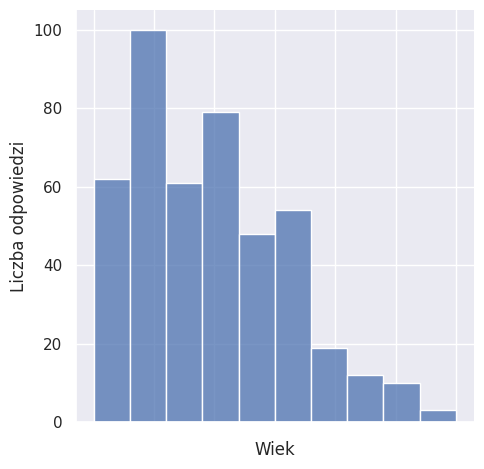

In [ ]:
ax = sns.displot(df['M2. Ile ma Pan/Pani lat?'], bins = 10)
ax.set(xlabel='Wiek', ylabel='Liczba odpowiedzi')
ax.set(xticklabels=[])
ax

In [ ]:
df.replace({'M2A. A gdybym mógł/mogła wpisać Pana/Panią do jednej z grup wiekowych – to do którego przedziału wiekowego mogę Pana/Panią przypisać?' : {'75-79': 77, '60-64': 62, '70-74': 72, '85-89': 87, '90 lat i więcej':92, '65-69':67,
       '80-84':82}}, inplace=True)
df['M2A. A gdybym mógł/mogła wpisać Pana/Panią do jednej z grup wiekowych – to do którego przedziału wiekowego mogę Pana/Panią przypisać?'].unique()

array([77, 62, 72, 87, 92, 67, 82])

In [ ]:
for i in range(df.shape[0]):
    if(df['M2. Ile ma Pan/Pani lat?'][i] == ""):
            df['M2. Ile ma Pan/Pani lat?'][i] = df['M2A. A gdybym mógł/mogła wpisać Pana/Panią do jednej z grup wiekowych – to do którego przedziału wiekowego mogę Pana/Panią przypisać?'][i]


Usuwamy niepotrzebną kolumnę z przedziałem wiekowym.

In [ ]:
df = df.drop('M2A. A gdybym mógł/mogła wpisać Pana/Panią do jednej z grup wiekowych – to do którego przedziału wiekowego mogę Pana/Panią przypisać?', axis=1)

Zmieniamy wartości na numeryczne.

In [ ]:
df['M2. Ile ma Pan/Pani lat?'] = pd.to_numeric(df['M2. Ile ma Pan/Pani lat?'])
df['M2. Ile ma Pan/Pani lat?'].unique()

array([75., 64., 72., 85., 90., 63., nan, 65., 76., 70., 74., 66., 61.,
       69., 71., 60., 67., 68., 62., 78., 77., 79., 84., 73., 81., 80.,
       86., 82., 87., 83., 88.])

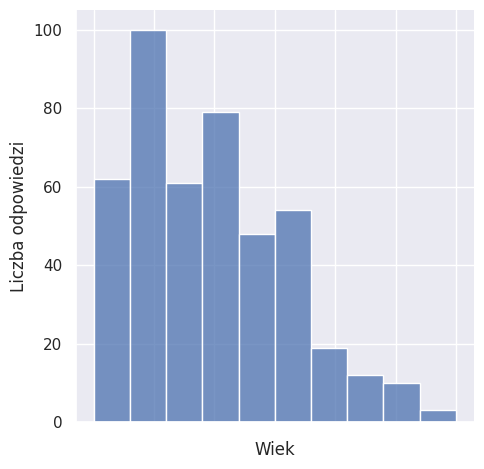

In [ ]:
ax = sns.displot(df['M2. Ile ma Pan/Pani lat?'], bins = 10)
ax.set(xlabel='Wiek', ylabel='Liczba odpowiedzi')
ax.set(xticklabels=[])
ax

In [ ]:
df['M2. Ile ma Pan/Pani lat?'].abs().max()

90.0

In [ ]:
df['M2. Ile ma Pan/Pani lat?'] = df['M2. Ile ma Pan/Pani lat?']/df['M2. Ile ma Pan/Pani lat?'].abs().max()
df['M2. Ile ma Pan/Pani lat?'].unique()

array([0.83333333, 0.71111111, 0.8       , 0.94444444, 1.        ,
       0.7       ,        nan, 0.72222222, 0.84444444, 0.77777778,
       0.82222222, 0.73333333, 0.67777778, 0.76666667, 0.78888889,
       0.66666667, 0.74444444, 0.75555556, 0.68888889, 0.86666667,
       0.85555556, 0.87777778, 0.93333333, 0.81111111, 0.9       ,
       0.88888889, 0.95555556, 0.91111111, 0.96666667, 0.92222222,
       0.97777778])

In [ ]:
df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'] = df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'].apply(extract_number)
for i in range(df.shape[0]):
    if(df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'][i] == ""):
            df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'][i] = np.nan

<ipython-input-208-8a9cf999d94b>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'][i] = np.nan


In [ ]:
df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'].value_counts()

2     250
1     158
3      49
4      14
5      12
6       7
7       2
8       2
22      1
Name: M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?, dtype: int64

<ipython-input-210-5e1d15a9606d>:2: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data=df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'],legend=False, palette="Blues_r")


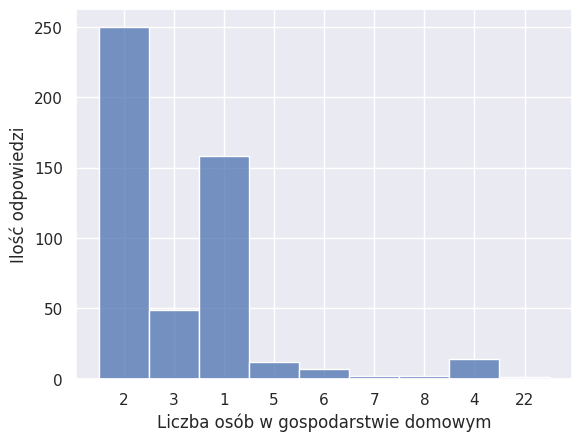

In [ ]:
sns.set(font_scale = 1)
sns.histplot(data=df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'],legend=False, palette="Blues_r")
plt.xlabel('Liczba osób w gospodarstwie domowym')
plt.ylabel('Ilość odpowiedzi')
plt.show()

Zamieniamy na opcje: 1, 2, 3, 4.

In [ ]:
for i in range(df.shape[0]):
  if (float(df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'][i]) >= 4):
    df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'][i] = '4'

<ipython-input-211-a7b63e010639>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'][i] = '4'


In [ ]:
df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'].value_counts() 

2    250
1    158
3     49
4     38
Name: M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?, dtype: int64

<ipython-input-213-907433fa1f48>:2: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data=df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'],palette="Blues_r")


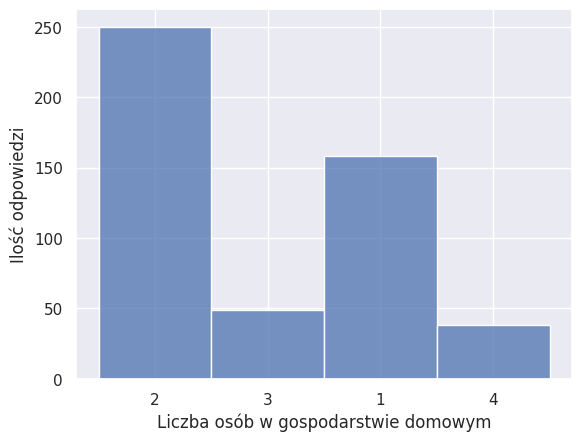

In [ ]:
sns.set(font_scale = 1)
sns.histplot(data=df['M3. Z ilu osób (razem z Panem/Panią) składa się Pana/Pani gospodarstwo domowe?'],palette="Blues_r")
plt.xlabel('Liczba osób w gospodarstwie domowym')
plt.ylabel('Ilość odpowiedzi')
plt.show()

In [ ]:
df['M3A. Ile z tych osób ma poniżej 6 lat?'].value_counts()

żadna                              327
                                   163
Wpisz: ( 1 )                         8
Wpisz: ( 3 )                         1
odmowa odpowiedzi [NIE CZYTAĆ!]      1
Name: M3A. Ile z tych osób ma poniżej 6 lat?, dtype: int64

Do tych, którzy mają dziecko poniżej 6 lat przypisujemy wartośc 1, a do tych którzy nie mają wartość 0.

In [ ]:
df['M3A. Ile z tych osób ma poniżej 6 lat?'] = df['M3A. Ile z tych osób ma poniżej 6 lat?'].apply(extract_number)
for i in range(df.shape[0]):
    if(df['M3A. Ile z tych osób ma poniżej 6 lat?'][i] == "" or df['M3A. Ile z tych osób ma poniżej 6 lat?'][i]==0):
        df['M3A. Ile z tych osób ma poniżej 6 lat?'][i] = 0
    else:
        df['M3A. Ile z tych osób ma poniżej 6 lat?'][i] = 1 

<ipython-input-215-27a371c72e92>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M3A. Ile z tych osób ma poniżej 6 lat?'][i] = 0
<ipython-input-215-27a371c72e92>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M3A. Ile z tych osób ma poniżej 6 lat?'][i] = 1


In [ ]:
df['M3A. Ile z tych osób ma poniżej 6 lat?'].unique()

array([0, 1], dtype=object)

In [ ]:
df['M3A. Ile z tych osób ma poniżej 6 lat?'].value_counts()

0    491
1      9
Name: M3A. Ile z tych osób ma poniżej 6 lat?, dtype: int64

In [ ]:
df['M8. W jakim rodzaju budownictwa Pan/i mieszka?'].value_counts()

Jednorodzinny (np. wolnostojące, szeregowe, bliźniacze)    265
Wielorodzinny (np. blok mieszkalny, kamienica)             232
Odmowa odpowiedzi                                            3
Name: M8. W jakim rodzaju budownictwa Pan/i mieszka?, dtype: int64

Zamieniamy na wartości -1, 0, 1.

In [ ]:
df.replace({'M8. W jakim rodzaju budownictwa Pan/i mieszka?' : {'Jednorodzinny (np. wolnostojące, szeregowe, bliźniacze)' : 1, 'Odmowa odpowiedzi' : 0, 'Wielorodzinny (np. blok mieszkalny, kamienica)' : -1 }}, inplace=True)
df['M8. W jakim rodzaju budownictwa Pan/i mieszka?'].value_counts()

 1    265
-1    232
 0      3
Name: M8. W jakim rodzaju budownictwa Pan/i mieszka?, dtype: int64

In [ ]:
df = df.drop(['M9. Czy w Pana/Pani gospodarstwie domowym (w którym Pan/Pani mieszka) jest samochód osobowy?'], axis = 1)


In [ ]:

df['M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?'] = df['M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?'].apply(extract_number)
for i in range(df.shape[0]):
    if(df['M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?'][i] == ""):
            df['M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?'][i] = 0

<ipython-input-221-33bdc3395c94>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?'][i] = 0


In [ ]:
df['M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?'].value_counts()

1    235
0    151
2     88
3     18
4      5
5      2
8      1
Name: M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?, dtype: int64

Jeżeli ktoś ma więcej niż 3 samochody, to zrównujemy ich liczbę do 3.

In [ ]:
for i in range(df.shape[0]):
    if(int(df['M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?'][i])>=3):
        df['M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?'][i] = 3;

<ipython-input-223-e77d142adf7d>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?'][i] = 3;


In [ ]:
df['M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?'].value_counts()

1    235
0    151
2     88
3     26
Name: M9A. Ile samochodów osobowych znajduje się w Pana/Pani gospodarstwie domowym?, dtype: int64

In [ ]:
df = df.drop(['M10. Czy w Pana/Pani gospodarstwie domowym (w którym Pan/Pani mieszka) znajdują się sprawne rowery (nie uwzględniając rowerów dziecięcych)?'], axis = 1)

Jeśli w gospodarstwie są więcej niż 4 rowery, to przypisujemy wartość 4.

In [ ]:
df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'].value_counts()

Wpisz liczbę: ( 2 )                149
                                   129
Wpisz liczbę: ( 1 )                128
Wpisz liczbę: ( 3 )                 53
Wpisz liczbę: ( 4 )                 23
Wpisz liczbę: ( 5 )                  9
odmowa odpowiedzi [NIE CZYTAĆ!]      4
Wpisz liczbę: ( 6 )                  2
Wpisz liczbę: ( 8 )                  1
Wpisz liczbę: ( 7 )                  1
Wpisz liczbę: ( 9 )                  1
Name: M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?, dtype: int64

In [ ]:
df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'] = df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'].apply(extract_number)
for i in range(df.shape[0]):
    if(df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'][i] == ""):
            df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'][i] = 0
    else:
        v= int(df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'][i])
        df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'][i] = min(int(df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'][i]), 4)


<ipython-input-227-34c51b5def46>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'][i] = min(int(df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'][i]), 4)
<ipython-input-227-34c51b5def46>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'][i] = 0


In [ ]:
df['M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?'].value_counts()

2    149
0    133
1    128
3     53
4     37
Name: M10A. Ile rowerów (nie uwzględniając rowerów dziecięcych) znajduje się w Pana/Pani gospodarstwie domowym?, dtype: int64

In [ ]:
df['M12. Proszę wybrać, który z przedziałów wartości dochodu netto (na rękę) na osobę najlepiej opisuje Pana/i gospodarstwo domowe.'].value_counts()

pomiędzy 1200 a 2000 zł na rękę na osobę    151
pomiędzy 2000 a 4000 zł na rękę na osobę    139
NIE chcę podać (NIE CZYTAĆ!!)               117
powyżej 4000 zł na rękę na osobę             38
pomiędzy 600 a 1200 zł na rękę na osobę      30
NIE WIEM (NIE CZYTAĆ!!)                      20
do 600 zł na rękę na osobę                    5
Name: M12. Proszę wybrać, który z przedziałów wartości dochodu netto (na rękę) na osobę najlepiej opisuje Pana/i gospodarstwo domowe., dtype: int64

Przypisujemy wartości: 0.25, 0.45, 0.9, 1.5, 2.25.

In [ ]:
df.replace({'M12. Proszę wybrać, który z przedziałów wartości dochodu netto (na rękę) na osobę najlepiej opisuje Pana/i gospodarstwo domowe.':{
                                'do 600 zł na rękę na osobę' : 0.25, 'pomiędzy 600 a 1200 zł na rękę na osobę' : 0.45,
                                'powyżej 4000 zł na rękę na osobę' : 2.25, 'pomiędzy 2000 a 4000 zł na rękę na osobę' : 1.5,
                                'pomiędzy 1200 a 2000 zł na rękę na osobę' : 0.9,
                                'NIE chcę podać (NIE CZYTAĆ!!)' : np.nan, 'NIE WIEM (NIE CZYTAĆ!!)' : np.nan }}, inplace = True)

Wartość 1 dopisujemy w miejsce gdzie nie ma odpowiedzi przy dochodzie netto, a 0 tam gdzie jest.

In [ ]:
df['M12A.Missing_val'] = np.where(df['M12. Proszę wybrać, który z przedziałów wartości dochodu netto (na rękę) na osobę najlepiej opisuje Pana/i gospodarstwo domowe.'].isnull(), 1, 0)

Przypisanie odpowiednich wartości do podanego wykształcenia.

In [ ]:
Q = {}
Q['wykształcenie wyższe (ANK: osoby, które na studiach wyższych I, II lub III stopnia, uzyskały tytuł zawodowy licencjata, inżyniera, magistra lub magistra inżyniera, lub uzyskały stopień naukowy doktora)']  = 5
Q['absolwent szkoły policealnej lub pomaturalnej'] = 4
Q['wykształcenie zawodowe (ANK: osoby, które ukończyły zasadniczą szkołę zawodową, szkołę zasadniczą lub inną szkołę równorzędną przed reformą w roku 2017) lub wykształcenie branżowe (ANK: osoby, które ukończyły branżową szkołę I stopnia)'] = 2
Q['wykształcenie średnie (ANK: osoby, które ukończyły branżową szkołę II stopnia, które ukończyły szkołę ponadpodstawową na podbudowie 8-klasowej szkoły podstawowej lub ukończyły szkołę ponadgimnazjalną z wyjątkiem zasadniczej szkoły zawodowej)'] = 3
Q['wykształcenie gimnazjalne (ANK: osoby, które ukończyły gimnazjum - jest ono odpowiednikiem wykształcenia podstawowego przed reformą w roku 2017)'] = 1
Q['wykształcenie podstawowe (ANK: osoby, które ukończyły szkołę podstawową lub podstawowe studium zawodowe)'] = 1
Q['brak wykształcenia (ANK: osoby, które nie ukończyły szkoły podstawowej)'] = 1
Q['odmowa odpowiedzi'] = np.nan
Q['Odmowa odpowiedzi'] = np.nan

In [ ]:
df.replace({'M14. Proszę wybrać, jakie ma Pan/i ukończone wykształcenie' : Q}, inplace = True)

In [ ]:
df['M14. Proszę wybrać, jakie ma Pan/i ukończone wykształcenie'].value_counts()

3.0    224
5.0    148
2.0     83
4.0     22
1.0     21
0.0      1
Name: M14. Proszę wybrać, jakie ma Pan/i ukończone wykształcenie, dtype: int64

In [ ]:
df['M15. Czy na dzień dzisiejszy posiada Pan/i uprawnienia do kierowania samochodem osobowym?'].value_counts()

Tak    338
Nie    162
Name: M15. Czy na dzień dzisiejszy posiada Pan/i uprawnienia do kierowania samochodem osobowym?, dtype: int64

Zmieniamy odpowiedzi na 1 (posiada prawo jazdy), 0 (nie posiada).

In [ ]:
df.replace({'M15. Czy na dzień dzisiejszy posiada Pan/i uprawnienia do kierowania samochodem osobowym?' : {'Tak' : 1, 'Nie' : 0}}, inplace = True)

In [ ]:
df['M16. Jakie było Pana/i podstawowe (przeciętnie zajmujące najwięcej czasu) zajęcie w ostatnich 7 dniach (jednokrotny wybór):'].value_counts()

emeryt                                                                       366
pracujący poza domem                                                          85
rencista                                                                      20
Inne (urlop, zwolnienie, kwarantanna, nie pracuję zajmuję się domem itp.)     14
pracujący zarobkowo w domu                                                    11
pracujący w trybie hybrydowym                                                  2
odmowa odpowiedzi (NIE CZYTAĆ!!)                                               1
bezrobotny/a                                                                   1
Name: M16. Jakie było Pana/i podstawowe (przeciętnie zajmujące najwięcej czasu) zajęcie w ostatnich 7 dniach (jednokrotny wybór):, dtype: int64

Tworzymy kolumny: Emeryt, Rencista.

In [ ]:
df['M16.Emeryt'] = np.where(df['M16. Jakie było Pana/i podstawowe (przeciętnie zajmujące najwięcej czasu) zajęcie w ostatnich 7 dniach (jednokrotny wybór):']=='emeryt', 1, 0)
df['M16.Rencista'] = np.where(df['M16. Jakie było Pana/i podstawowe (przeciętnie zajmujące najwięcej czasu) zajęcie w ostatnich 7 dniach (jednokrotny wybór):']=='rencista', 1, 0)

Tworzymy kolumny: Pracujący, Inne.

In [ ]:
df['M16.Pracujacy'] = np.zeros(df.shape[0])
df['M16.Inne'] = np.zeros(df.shape[0])
Working = {'pracujący w trybie hybrydowym', 'pracujący zarobkowo w domu', 'pracujący poza domem'}
for i in range(df.shape[0]):
    if (df['M16. Jakie było Pana/i podstawowe (przeciętnie zajmujące najwięcej czasu) zajęcie w ostatnich 7 dniach (jednokrotny wybór):'][i] in Working):
        df['M16.Pracujacy'][i] = 1
    else:
        df['M16.Pracujacy'][i] = 0
Others = {'bezrobotny/a ', 'odmowa odpowiedzi (NIE CZYTAĆ!!)', 'Inne (urlop, zwolnienie, kwarantanna, nie pracuję zajmuję się domem itp.)'}
for i in range(df.shape[0]):
    if (df['M16. Jakie było Pana/i podstawowe (przeciętnie zajmujące najwięcej czasu) zajęcie w ostatnich 7 dniach (jednokrotny wybór):'][i] in Others):
        df['M16.Inne'][i] = 1
    else:
        df['M16.Inne'][i] = 0

<ipython-input-239-94353b7bd0bd>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M16.Pracujacy'][i] = 0
<ipython-input-239-94353b7bd0bd>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M16.Pracujacy'][i] = 1
<ipython-input-239-94353b7bd0bd>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['M16.Inne'][i] = 0
<ipython-input-239-94353b7bd0bd>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

In [ ]:
df = df.drop('M16. Jakie było Pana/i podstawowe (przeciętnie zajmujące najwięcej czasu) zajęcie w ostatnich 7 dniach (jednokrotny wybór):', axis=1)

In [ ]:
df['M16.1. Gdzie pracuje Pan/i?'].value_counts()

                                  402
w moim mieście                     61
poza moim miastem zamieszkania     37
Name: M16.1. Gdzie pracuje Pan/i?, dtype: int64

Przypisujemy wartości -1, 0, 1.

In [ ]:
df.replace({'M16.1. Gdzie pracuje Pan/i?' : {'w moim mieście' : 1, 'poza moim miastem zamieszkania' : -1, "" :0 } } , inplace = True)

In [ ]:
df['M16.1. Gdzie pracuje Pan/i?'].value_counts()

      402
1      61
-1     37
Name: M16.1. Gdzie pracuje Pan/i?, dtype: int64

In [ ]:
df.replace({'M16.1. Gdzie pracuje Pan/i?': {' ':0}}, inplace = True)

Usuwamy wszystkie 3 kolumny - zbyt mała liczba odpowiedzi.

In [ ]:
df = df.drop(['M16.3 W jakiej gminie?', 'M16.3 A w jakim powiecie lub mieście?', 'M16.2 W jakim województwie?'], axis=1)

Usuwamy pierwszą pustą kolumnę z pytania 3.

In [ ]:
df = df.drop(['3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:'], axis=1)

Do odpowiedzi przypisujemy odpowiednią skalę.

In [ ]:
A1 = {}
A1['praca - skala:1 - codziennie (dni powszednie)']  = 1
A1['praca - skala:2 - kilka razy w tygodniu (dni powszednie)'] = 2
A1['praca - skala:3 - w weekendy'] = 3
A1['praca - skala:4 - kilka razy w miesiącu'] = 4
A1['praca - skala:5 - raz w miesiącu'] = 5
A1['praca - skala:6 - w ostatnim miesiącu ani razu'] = 6
A1['praca - skala:7 - nie dotyczy'] = 7
A1['praca - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
A2 = {}
A2['zakupy codzienne (spożywcze) - skala:1 - codziennie (dni powszednie)'] = 1
A2['zakupy codzienne (spożywcze) - skala:2 - kilka razy w tygodniu (dni powszednie)'] = 2
A2['zakupy codzienne (spożywcze) - skala:3 - w weekendy'] = 3
A2['zakupy codzienne (spożywcze) - skala:4 - kilka razy w miesiącu'] = 4
A2['zakupy codzienne (spożywcze) - skala:5 - raz w miesiącu'] = 5
A2['zakupy codzienne (spożywcze) - skala:6 - w ostatnim miesiącu ani razu'] = 6
A2['zakupy codzienne (spożywcze) - skala:7 - nie dotyczy'] = 7
A2['zakupy codzienne (spożywcze) - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
A3 = {}
A3['sprawy urzędowe - skala:1 - codziennie (dni powszednie)']  = 1
A3['sprawy urzędowe - skala:2 - kilka razy w tygodniu (dni powszednie)'] = 2
A3['sprawy urzędowe - skala:3 - w weekendy'] = 3
A3['sprawy urzędowe - skala:4 - kilka razy w miesiącu'] = 4
A3['sprawy urzędowe - skala:5 - raz w miesiącu'] = 5
A3['sprawy urzędowe - skala:6 - w ostatnim miesiącu ani razu'] = 6
A3['sprawy urzędowe - skala:7 - nie dotyczy'] = 7
A3['sprawy urzędowe - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
A4 = {}
A4['kościół - skala:1 - codziennie (dni powszednie)']  = 1
A4['kościół - skala:2 - kilka razy w tygodniu (dni powszednie)'] = 2
A4['kościół - skala:3 - w weekendy'] = 3
A4['kościół - skala:4 - kilka razy w miesiącu'] = 4
A4['kościół - skala:5 - raz w miesiącu'] = 5
A4['kościół - skala:6 - w ostatnim miesiącu ani razu'] = 6
A4['kościół - skala:7 - nie dotyczy'] = 7
A4['kościół - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
A5 = {}
A5['odwiedziny u znajomych/rodziny - skala:1 - codziennie (dni powszednie)']  = 1
A5['odwiedziny u znajomych/rodziny - skala:2 - kilka razy w tygodniu (dni powszednie)'] = 2
A5['odwiedziny u znajomych/rodziny - skala:3 - w weekendy'] = 3
A5['odwiedziny u znajomych/rodziny - skala:4 - kilka razy w miesiącu'] = 4
A5['odwiedziny u znajomych/rodziny - skala:5 - raz w miesiącu'] = 5
A5['odwiedziny u znajomych/rodziny - skala:6 - w ostatnim miesiącu ani razu'] = 6
A5['odwiedziny u znajomych/rodziny - skala:7 - nie dotyczy'] = 7
A5['odwiedziny u znajomych/rodziny - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
A6 = {}
A6['lekarz - skala:1 - codziennie (dni powszednie)']  = 1
A6['lekarz - skala:2 - kilka razy w tygodniu (dni powszednie)'] = 2
A6['lekarz - skala:3 - w weekendy'] = 3
A6['lekarz - skala:4 - kilka razy w miesiącu'] = 4
A6['lekarz - skala:5 - raz w miesiącu'] = 5
A6['lekarz - skala:6 - w ostatnim miesiącu ani razu'] = 6
A6['lekarz - skala:7 - nie dotyczy'] = 7
A6['lekarz - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
A7 = {}
A7['rozrywka, kultura - skala:1 - codziennie (dni powszednie)']  = 1
A7['rozrywka, kultura - skala:2 - kilka razy w tygodniu (dni powszednie)'] = 2
A7['rozrywka, kultura - skala:3 - w weekendy'] = 3
A7['rozrywka, kultura - skala:4 - kilka razy w miesiącu'] = 4
A7['rozrywka, kultura - skala:5 - raz w miesiącu'] = 5
A7['rozrywka, kultura - skala:6 - w ostatnim miesiącu ani razu'] = 6
A7['rozrywka, kultura - skala:7 - nie dotyczy'] = 7
A7['rozrywka, kultura - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
A8 = {}
A8['fryzjer/kosmetyczka - skala:1 - codziennie (dni powszednie)']  = 1
A8['fryzjer/kosmetyczka - skala:2 - kilka razy w tygodniu (dni powszednie)'] = 2
A8['fryzjer/kosmetyczka - skala:3 - w weekendy'] = 3
A8['fryzjer/kosmetyczka - skala:4 - kilka razy w miesiącu'] = 4
A8['fryzjer/kosmetyczka - skala:5 - raz w miesiącu'] = 5
A8['fryzjer/kosmetyczka - skala:6 - w ostatnim miesiącu ani razu'] = 6
A8['fryzjer/kosmetyczka - skala:7 - nie dotyczy'] = 7
A8['fryzjer/kosmetyczka - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
A9 = {}
A9['szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora) - skala:1 - codziennie (dni powszednie)']  = 1
A9['szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora) - skala:2 - kilka razy w tygodniu (dni powszednie)'] = 2
A9['szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora) - skala:3 - w weekendy'] = 3
A9['szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora) - skala:4 - kilka razy w miesiącu'] = 4
A9['szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora) - skala:5 - raz w miesiącu'] = 5
A9['szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora) - skala:6 - w ostatnim miesiącu ani razu'] = 6
A9['szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora) - skala:7 - nie dotyczy'] = 7
A9['szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora) - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
A10 = {}
A10['dzienny dom pomocy społecznej/ dom dziennego pobytu - skala:1 - codziennie (dni powszednie)']  = 1
A10['dzienny dom pomocy społecznej/ dom dziennego pobytu - skala:2 - kilka razy w tygodniu (dni powszednie)'] = 2
A10['dzienny dom pomocy społecznej/ dom dziennego pobytu - skala:3 - w weekendy'] = 3
A10['dzienny dom pomocy społecznej/ dom dziennego pobytu - skala:4 - kilka razy w miesiącu'] = 4
A10['dzienny dom pomocy społecznej/ dom dziennego pobytu - skala:5 - raz w miesiącu'] = 5
A10['dzienny dom pomocy społecznej/ dom dziennego pobytu - skala:6 - w ostatnim miesiącu ani razu'] = 6
A10['dzienny dom pomocy społecznej/ dom dziennego pobytu - skala:7 - nie dotyczy'] = 7
A10['dzienny dom pomocy społecznej/ dom dziennego pobytu - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan

In [ ]:
df.replace({'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.1' : A1}, inplace = True)
df.replace({'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.2' : A2}, inplace = True)
df.replace({'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.3' : A3}, inplace = True)
df.replace({'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.4' : A4}, inplace = True)
df.replace({'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.5' : A5}, inplace = True)
df.replace({'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.6' : A6}, inplace = True)
df.replace({'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.7' : A7}, inplace = True)
df.replace({'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.8' : A8}, inplace = True)
df.replace({'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.9' : A9}, inplace = True)
df.replace({'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.10' : A10}, inplace = True)


Zmieniamy nazwy kolumn.

In [ ]:
df.rename(columns={
    '3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.1':'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.praca',
    '3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.2':'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.zakupy codzienne (spożywcze)',
    '3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.3':'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.sprawy urzędowe',
    '3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.4':'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.kościół',
    '3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.5':'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.odwiedziny u znajomych/rodziny',
    '3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.6':'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.lekarz',
    '3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.7':'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.rozrywka, kultura',
    '3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.8':'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.fryzjer/kosmetyczka',
    '3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.9':'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora)',
    '3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.10':'3. Proszę określić jak często załatwiał/a Pan/Pani poniższe sprawy w ostatnim miesiącu:.dzienny dom pomocy społecznej/ dom dziennego pobytu'
}, inplace=True)

Przy więcej niż jednej liczbie odpowiedzi w pytaniu 4 łączymy je w jedną.

In [ ]:
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca']
for i in range(1,9):
  df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca_sumup'] + df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca.'+str(i)]
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca_sumup'].str.split().str.join(' ')

df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - zakupy codzienne (spożywcze)_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - zakupy codzienne (spożywcze)']
for i in range(1,9):
  df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - zakupy codzienne (spożywcze)_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - zakupy codzienne (spożywcze)_sumup'] + df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - zakupy codzienne (spożywcze).'+str(i)]
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - zakupy codzienne (spożywcze)_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - zakupy codzienne (spożywcze)_sumup'].str.split().str.join(' ')

df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe']
for i in range(1,9):
  df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe_sumup'] + df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe.'+str(i)]
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe_sumup'].str.split().str.join(' ')

df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - kościół_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - kościół']
for i in range(1,9):
  df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - kościół_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - kościół_sumup'] + df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - kościół.'+str(i)]
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - kościół_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - kościół_sumup'].str.split().str.join(' ')

df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - odwiedziny u znajomych/rodziny_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - odwiedziny u znajomych/rodziny']
for i in range(1,9):
  df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - odwiedziny u znajomych/rodziny_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - odwiedziny u znajomych/rodziny_sumup'] + df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - odwiedziny u znajomych/rodziny.'+str(i)]
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - odwiedziny u znajomych/rodziny_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - odwiedziny u znajomych/rodziny_sumup'].str.split().str.join(' ')

df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - lekarz_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - lekarz']
for i in range(1,9):
  df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - lekarz_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - lekarz_sumup'] + df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - lekarz.'+str(i)]
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - lekarz_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - lekarz_sumup'].str.split().str.join(' ')

df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - rozrywka, kultura_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - rozrywka, kultura']
for i in range(1,9):
  df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - rozrywka, kultura_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - rozrywka, kultura_sumup'] + df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - rozrywka, kultura.'+str(i)]
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - rozrywka, kultura_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - rozrywka, kultura_sumup'].str.split().str.join(' ')

df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - fryzjer/kosmetyczka_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - fryzjer/kosmetyczka']
for i in range(1,9):
  df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - fryzjer/kosmetyczka_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - fryzjer/kosmetyczka_sumup'] + df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - fryzjer/kosmetyczka.'+str(i)]
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - fryzjer/kosmetyczka_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - fryzjer/kosmetyczka_sumup'].str.split().str.join(' ')

df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora)_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora)']
for i in range(1,9):
  df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora)_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora)_sumup'] + df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora).'+str(i)]
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora)_sumup'] = df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora)_sumup'].str.split().str.join(' ')


Nie korzystamy z '4.[...] - dzienny dom pomocy społecznej/ dom dziennego pobytu', ponieważ nie ma żadnej odpowiedzi.


Usuwamy niepotrzebne kolumny.

In [ ]:
for i in range(1,10):
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca.'+str(i)], axis = 1)
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - zakupy codzienne (spożywcze).'+str(i)], axis = 1)
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe.'+str(i)], axis = 1)
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - kościół.'+str(i)], axis = 1)
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - odwiedziny u znajomych/rodziny.'+str(i)], axis = 1)
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - lekarz.'+str(i)], axis = 1)
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - rozrywka, kultura.'+str(i)], axis = 1)
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - fryzjer/kosmetyczka.'+str(i)], axis = 1)
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora).'+str(i)], axis = 1)
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - dzienny dom pomocy społecznej/ dom dziennego pobytu.'+str(i)], axis = 1)

df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca'], axis = 1)
df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - zakupy codzienne (spożywcze)'], axis = 1)
df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe'], axis = 1)
df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - kościół'], axis = 1)
df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - odwiedziny u znajomych/rodziny'], axis = 1)
df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - lekarz'], axis = 1)
df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - rozrywka, kultura'], axis = 1)
df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - fryzjer/kosmetyczka'], axis = 1)
df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora)'], axis = 1)
df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - dzienny dom pomocy społecznej/ dom dziennego pobytu'], axis = 1)

Łączymy poniższe odpowiedzi jako transport publiczny.

In [ ]:
R = {'bus/PKS', 'autobus miejski (np. MPK, MZK)', 'pociąg'}

col = ['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - praca_sumup',
    '4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - zakupy codzienne (spożywcze)_sumup',
    '4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe_sumup',
    '4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - kościół_sumup',
    '4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - odwiedziny u znajomych/rodziny_sumup',
    '4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - lekarz_sumup',
    '4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - rozrywka, kultura_sumup',
    '4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - fryzjer/kosmetyczka_sumup',
    '4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora)_sumup'
  ]

for j in col:
  for i in range(df.shape[0]):
    if (df[j][i] in R):
      df[j][i] = 'transport publiczny'


<ipython-input-252-29e8e138eae6>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[j][i] = 'transport publiczny'


Jeżeli ktoś podał więcej niż jedną odpowiedź, łączymy je i dodajemy do odpowiedzi 'inne/więcej niż 1 środek transportu'.

In [ ]:
P = {'wyłącznie pieszo', 'samochód (jako kierowca)', 'samochód (jako pasażer)', 'rower', 'transport publiczny', ''}

for j in col:
  for i in range(df.shape[0]):
    if (df[j][i] not in P):
      df[j][i] = 'inne/więcej niż 1 środek transportu'

<ipython-input-253-f5ca9628d6ef>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[j][i] = 'inne/więcej niż 1 środek transportu'


In [ ]:
df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe_sumup'].value_counts()

                                       320
samochód (jako kierowca)                74
wyłącznie pieszo                        66
rower                                   21
samochód (jako pasażer)                  9
inne/więcej niż 1 środek transportu      6
transport publiczny                      4
Name: 4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - sprawy urzędowe_sumup, dtype: int64

Tworzymy nowe kolumny, a następnie przypisujemy wartości 0-1.

In [ ]:
W = {'praca', 'zakupy codzienne (spożywcze)', 'sprawy urzędowe', 'kościół', 'odwiedziny u znajomych/rodziny', 'lekarz', 'rozrywka, kultura', 'fryzjer/kosmetyczka', 'szkolenia/warsztaty/rozwijanie umiejętności (np. klub seniora)'}
for i in W:
  df['4.'+str(i)+'_samochód (jako kierowca)'] = np.zeros(df.shape[0])
  df['4.'+str(i)+'_wyłącznie pieszo'] = np.zeros(df.shape[0])
  df['4.'+str(i)+'_rower'] = np.zeros(df.shape[0])
  df['4.'+str(i)+'_samochód (jako pasażer)'] = np.zeros(df.shape[0])
  df['4.'+str(i)+'_inne/więcej niż 1 środek transportu'] = np.zeros(df.shape[0])
  df['4.'+str(i)+'_transport publiczny'] = np.zeros(df.shape[0])

In [ ]:
for i in W:
  for j in range(df.shape[0]):
    if df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - '+str(i)+'_sumup'][j] == 'samochód (jako kierowca)':
        df['4.'+str(i)+'_samochód (jako kierowca)'][j] = 1
    else:
        df['4.'+str(i)+'_samochód (jako kierowca)'][j] = 0

    if df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - '+str(i)+'_sumup'][j] == 'wyłącznie pieszo':
        df['4.'+str(i)+'_wyłącznie pieszo'][j] = 1
    else:
        df['4.'+str(i)+'_wyłącznie pieszo'][j] = 0
    
    if df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - '+str(i)+'_sumup'][j] == 'rower':
        df['4.'+str(i)+'_rower'][j] = 1
    else:
        df['4.'+str(i)+'_rower'][j] = 0
    
    if df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - '+str(i)+'_sumup'][j] == 'samochód (jako pasażer)':
        df['4.'+str(i)+'_samochód (jako pasażer)'][j] = 1
    else:
        df['4.'+str(i)+'_samochód (jako pasażer)'][j] = 0
    
    if df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - '+str(i)+'_sumup'][j] == 'inne/więcej niż 1 środek transportu':
        df['4.'+str(i)+'_inne/więcej niż 1 środek transportu'][j] = 1
    else:
        df['4.'+str(i)+'_inne/więcej niż 1 środek transportu'][j] = 0
    
    if df['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - '+str(i)+'_sumup'][j] == 'transport publiczny':
        df['4.'+str(i)+'_transport publiczny'][j] = 1
    else:
        df['4.'+str(i)+'_transport publiczny'][j] = 0


<ipython-input-256-99329d7599f0>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['4.'+str(i)+'_samochód (jako kierowca)'][j] = 0
<ipython-input-256-99329d7599f0>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['4.'+str(i)+'_wyłącznie pieszo'][j] = 1
<ipython-input-256-99329d7599f0>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['4.'+str(i)+'_rower'][j] = 0
<ipython-input-256-99329d7599f0>:21: SettingWithCopyWarning: 
A va

In [ ]:
for i in W:
  df = df.drop(['4. Proszę określić jaki środek transportu najczęściej wykorzystywał/a Pan/Pani w ostatnim miesiącu, do załatwienia poniższych spraw (proszę wskazać więcej niż jedną odpowiedź tylko w sytuacji, jeśli była to podróż z przesiadką): - '+str(i)+'_sumup'], axis = 1)

Pytanie 5:
- usuwamy 2 puste kolumny kolumny + 1 kolumnę z 44 odpowiedziami
- resztę zamieniamy na skalę: 0 (puste wartości lub brak odpowiedzi), 1, 2, 3, 4

In [ ]:
df = df.drop(['5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):'], axis = 1)
df = df.drop(['5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.9'], axis = 1)
df = df.drop(['5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.10'], axis = 1)

In [ ]:
df['5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.1'].unique()

array([' ', 'praca - skala:4 - powyżej 1000 metrów',
       'praca - skala:3 - 500-1000 metrów',
       'praca - skala:1 - do 250 metrów',
       'praca - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)',
       'praca - skala:2 - 250-500 metrów'], dtype=object)

In [ ]:
Q1 = {}
Q1['praca - skala:1 - do 250 metrów']  = 1
Q1['praca - skala:2 - 250-500 metrów'] = 2
Q1['praca - skala:3 - 500-1000 metrów'] = 3
Q1['praca - skala:4 - powyżej 1000 metrów'] = 4
Q1['praca - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Q2 = {}
Q2['zakupy codzienne (spożywcze) - skala:1 - do 250 metrów']  = 1
Q2['zakupy codzienne (spożywcze) - skala:2 - 250-500 metrów'] = 2
Q2['zakupy codzienne (spożywcze) - skala:3 - 500-1000 metrów'] = 3
Q2['zakupy codzienne (spożywcze) - skala:4 - powyżej 1000 metrów'] = 4
Q2['zakupy codzienne (spożywcze) - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Q3 = {}
Q3['sprawy urzędowe - skala:1 - do 250 metrów']  = 1
Q3['sprawy urzędowe - skala:2 - 250-500 metrów'] = 2
Q3['sprawy urzędowe - skala:3 - 500-1000 metrów'] = 3
Q3['sprawy urzędowe - skala:4 - powyżej 1000 metrów'] = 4
Q3['sprawy urzędowe - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Q4 = {}
Q4['kościół - skala:1 - do 250 metrów']  = 1
Q4['kościół - skala:2 - 250-500 metrów'] = 2
Q4['kościół - skala:3 - 500-1000 metrów'] = 3
Q4['kościół - skala:4 - powyżej 1000 metrów'] = 4
Q4['kościół - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Q5 = {}
Q5['odwiedziny u znajomych/rodziny - skala:1 - do 250 metrów']  = 1
Q5['odwiedziny u znajomych/rodziny - skala:2 - 250-500 metrów'] = 2
Q5['odwiedziny u znajomych/rodziny - skala:3 - 500-1000 metrów'] = 3
Q5['odwiedziny u znajomych/rodziny - skala:4 - powyżej 1000 metrów'] = 4
Q5['odwiedziny u znajomych/rodziny - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Q6 = {}
Q6['lekarz - skala:1 - do 250 metrów']  = 1
Q6['lekarz - skala:2 - 250-500 metrów'] = 2
Q6['lekarz - skala:3 - 500-1000 metrów'] = 3
Q6['lekarz - skala:4 - powyżej 1000 metrów'] = 4
Q6['lekarz - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Q7 = {}
Q7['rozrywka, kultura - skala:1 - do 250 metrów']  = 1
Q7['rozrywka, kultura - skala:2 - 250-500 metrów'] = 2
Q7['rozrywka, kultura - skala:3 - 500-1000 metrów'] = 3
Q7['rozrywka, kultura - skala:4 - powyżej 1000 metrów'] = 4
Q7['rozrywka, kultura - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Q8 = {}
Q8['fryzjer/kosmetyczka - skala:1 - do 250 metrów']  = 1
Q8['fryzjer/kosmetyczka - skala:2 - 250-500 metrów'] = 2
Q8['fryzjer/kosmetyczka - skala:3 - 500-1000 metrów'] = 3
Q8['fryzjer/kosmetyczka - skala:4 - powyżej 1000 metrów'] = 4
Q8['fryzjer/kosmetyczka - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan

In [ ]:
df.replace({'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.1' : Q1}, inplace = True)
df.replace({'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.2' : Q2}, inplace = True)
df.replace({'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.3' : Q3}, inplace = True)
df.replace({'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.4' : Q4}, inplace = True)
df.replace({'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.5' : Q5}, inplace = True)
df.replace({'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.6' : Q6}, inplace = True)
df.replace({'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.7' : Q7}, inplace = True)
df.replace({'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.8' : Q8}, inplace = True)


Zmieniamy nazwy kolumn, tak jak w pytaniu 3.

In [ ]:
df.rename(columns={
    '5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu).1':'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.praca',
    '5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu).2':'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.zakupy codzienne (spożywcze)',
    '5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu).3':'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu).sprawy urzędowe',
    '5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu).4':'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.kościół',
    '5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu).5':'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.odwiedziny u znajomych/rodziny',
    '5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu).6':'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.lekarz',
    '5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu).7':'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.rozrywka, kultura',
    '5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu).8':'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.fryzjer/kosmetyczka',
}, inplace=True)

In [ ]:
df['5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.8'].value_counts()

     224
4     82
1     77
2     64
3     48
Name: 5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.8, dtype: int64

In [ ]:
for i in range(1,9):
    df.replace({'5. Proszę określić jaką średnią odległość (w jedną stronę) pokonywał/a Pan/Pani w ostatnim miesiącu, aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.'+str(i) : {' ' : 0}}, inplace = True)

Pytanie 6:
- usuwamy 2 puste kolumny kolumny + 1 kolumnę z 44 odpowiedziami
- resztę zamieniamy na skalę: 0 (puste wartości lub brak odpowiedzi), 1, 2, 3, 4

In [ ]:
df = df.drop(['6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):'], axis = 1)
df = df.drop(['6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.9'], axis = 1)
df = df.drop(['6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.10'], axis = 1)

In [ ]:
X1 = {}
X1['praca - skala:1 - do 5 minut']  = 1
X1['praca - skala:2 - 5-10 minut'] = 2
X1['praca - skala:3 - 10-20 minut'] = 3
X1['praca - skala:4 - powyżej 20 minut'] = 4
X1['praca - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
X2 = {}
X2['zakupy codzienne (spożywcze) - skala:1 - do 5 minut']  = 1
X2['zakupy codzienne (spożywcze) - skala:2 - 5-10 minut'] = 2
X2['zakupy codzienne (spożywcze) - skala:3 - 10-20 minut'] = 3
X2['zakupy codzienne (spożywcze) - skala:4 - powyżej 20 minut'] = 4
X2['zakupy codzienne (spożywcze) - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
X3 = {}
X3['sprawy urzędowe - skala:1 - do 5 minut']  = 1
X3['sprawy urzędowe - skala:2 - 5-10 minut'] = 2
X3['sprawy urzędowe - skala:3 - 10-20 minut'] = 3
X3['sprawy urzędowe - skala:4 - powyżej 20 minut'] = 4
X3['sprawy urzędowe - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
X4 = {}
X4['kościół - skala:1 - do 5 minut']  = 1
X4['kościół - skala:2 - 5-10 minut'] = 2
X4['kościół - skala:3 - 10-20 minut'] = 3
X4['kościół - skala:4 - powyżej 20 minut'] = 4
X4['kościół - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
X5 = {}
X5['odwiedziny u znajomych/rodziny - skala:1 - do 5 minut']  = 1
X5['odwiedziny u znajomych/rodziny - skala:2 - 5-10 minut'] = 2
X5['odwiedziny u znajomych/rodziny - skala:3 - 10-20 minut'] = 3
X5['odwiedziny u znajomych/rodziny - skala:4 - powyżej 20 minut'] = 4
X5['odwiedziny u znajomych/rodziny - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
X6 = {}
X6['lekarz - skala:1 - do 5 minut']  = 1
X6['lekarz - skala:2 - 5-10 minut'] = 2
X6['lekarz - skala:3 - 10-20 minut'] = 3
X6['lekarz - skala:4 - powyżej 20 minut'] = 4
X6['lekarz - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
X7 = {}
X7['rozrywka, kultura - skala:1 - do 5 minut']  = 1
X7['rozrywka, kultura - skala:2 - 5-10 minut'] = 2
X7['rozrywka, kultura - skala:3 - 10-20 minut'] = 3
X7['rozrywka, kultura - skala:4 - powyżej 20 minut'] = 4
X7['rozrywka, kultura - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
X8 = {}
X8['fryzjer/kosmetyczka - skala:1 - do 5 minut']  = 1
X8['fryzjer/kosmetyczka - skala:2 - 5-10 minut'] = 2
X8['fryzjer/kosmetyczka - skala:3 - 10-20 minut'] = 3
X8['fryzjer/kosmetyczka - skala:4 - powyżej 20 minut'] = 4
X8['fryzjer/kosmetyczka - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan

In [ ]:
df.replace({'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.1' : X1}, inplace = True)
df.replace({'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.2' : X2}, inplace = True)
df.replace({'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.3' : X3}, inplace = True)
df.replace({'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.4' : X4}, inplace = True)
df.replace({'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.5' : X5}, inplace = True)
df.replace({'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.6' : X6}, inplace = True)
df.replace({'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.7' : X7}, inplace = True)
df.replace({'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.8' : X8}, inplace = True)

Zmieniamy nazwy kolumn.

In [ ]:
df.rename(columns={
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.1':'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.praca',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.2':'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.zakupy codzienne (spożywcze)',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.3':'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.sprawy urzędowe',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.4':'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.kościół',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.5':'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.odwiedziny u znajomych/rodziny',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.6':'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.lekarz',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.7':'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.rozrywka, kultura',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.8':'6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.fryzjer/kosmetyczka',
}, inplace=True)

In [ ]:
colnames = ['6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.praca','6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.zakupy codzienne (spożywcze)','6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.sprawy urzędowe',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.kościół',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.odwiedziny u znajomych/rodziny',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.lekarz',
    '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.rozrywka, kultura',
        '6. Proszę określić ile czasu w ostatnim miesiącu średnio zajmowała Panu/Pani droga w jedną stronę aby załatwić poniższe sprawy (dotyczy jednorazowego wyjścia z domu):.fryzjer/kosmetyczka']

In [ ]:
for name in colnames:
    df.replace({name : {' ':0}}, inplace = True)

Pytanie 7:
- usuwamy 2 puste kolumny kolumny + 1 kolumnę z 44 odpowiedziami
- resztę zamieniamy na skalę: 0 (puste wartości lub brak odpowiedzi), 1, 2, 3, 4

In [ ]:
df = df.drop(['7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?'], axis = 1)
df = df.drop(['7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.9'], axis = 1)
df = df.drop(['7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.10'], axis = 1)

In [ ]:
Y1 = {}
Y1['praca - skala:1 - do 15 minut']  = 1
Y1['praca - skala:2 - 15-30 minut'] = 2
Y1['praca - skala:3 - 31-60 minut'] = 3
Y1['praca - skala:4 - powyżej 1 godziny'] = 4
Y1['praca - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Y2 = {}
Y2['zakupy codzienne (spożywcze) - skala:1 - do 15 minut']  = 1
Y2['zakupy codzienne (spożywcze) - skala:2 - 15-30 minut'] = 2
Y2['zakupy codzienne (spożywcze) - skala:3 - 31-60 minut'] = 3
Y2['zakupy codzienne (spożywcze) - skala:4 - powyżej 1 godziny'] = 4
Y2['zakupy codzienne (spożywcze) - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Y3 = {}
Y3['sprawy urzędowe - skala:1 - do 15 minut']  = 1
Y3['sprawy urzędowe - skala:2 - 15-30 minut'] = 2
Y3['sprawy urzędowe - skala:3 - 31-60 minut'] = 3
Y3['sprawy urzędowe - skala:4 - powyżej 1 godziny'] = 4
Y3['sprawy urzędowe - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Y4 = {}
Y4['kościół - skala:1 - do 15 minut']  = 1
Y4['kościół - skala:2 - 15-30 minut'] = 2
Y4['kościół - skala:3 - 31-60 minut'] = 3
Y4['kościół - skala:4 - powyżej 1 godziny'] = 4
Y4['kościół - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Y5 = {}
Y5['odwiedziny u znajomych/rodziny - skala:1 - do 15 minut']  = 1
Y5['odwiedziny u znajomych/rodziny - skala:2 - 15-30 minut'] = 2
Y5['odwiedziny u znajomych/rodziny - skala:3 - 31-60 minut'] = 3
Y5['odwiedziny u znajomych/rodziny - skala:4 - powyżej 1 godziny'] = 4
Y5['odwiedziny u znajomych/rodziny - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Y6 = {}
Y6['lekarz - skala:1 - do 15 minut']  = 1
Y6['lekarz - skala:2 - 15-30 minut'] = 2
Y6['lekarz - skala:3 - 31-60 minut'] = 3
Y6['lekarz - skala:4 - powyżej 1 godziny'] = 4
Y6['lekarz - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Y7 = {}
Y7['rozrywka, kultura - skala:1 - do 15 minut']  = 1
Y7['rozrywka, kultura - skala:2 - 15-30 minut'] = 2
Y7['rozrywka, kultura - skala:3 - 31-60 minut'] = 3
Y7['rozrywka, kultura - skala:4 - powyżej 1 godziny'] = 4
Y7['rozrywka, kultura - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan
Y8 = {}
Y8['fryzjer/kosmetyczka - skala:1 - do 15 minut']  = 1
Y8['fryzjer/kosmetyczka - skala:2 - 15-30 minut'] = 2
Y8['fryzjer/kosmetyczka - skala:3 - 31-60 minut'] = 3
Y8['fryzjer/kosmetyczka - skala:4 - powyżej 1 godziny'] = 4
Y8['fryzjer/kosmetyczka - skala:99 - odmowa odpowiedzi (NIE CZYTAĆ!!)'] = np.nan

In [ ]:
df.replace({'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.1' : Y1}, inplace = True)
df.replace({'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.2' : Y2}, inplace = True)
df.replace({'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.3' : Y3}, inplace = True)
df.replace({'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.4' : Y4}, inplace = True)
df.replace({'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.5' : Y5}, inplace = True)
df.replace({'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.6' : Y6}, inplace = True)
df.replace({'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.7' : Y7}, inplace = True)
df.replace({'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.8' : Y8}, inplace = True)

Zmieniamy nazwy kolumn.

In [ ]:
df.rename(columns={
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.1':'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.praca',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.2':'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.zakupy codzienne (spożywcze)',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.3':'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.sprawy urzędowe',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.4':'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.kościół',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.5':'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.odwiedziny u znajomych/rodziny',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.6':'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.lekarz',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.7':'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.rozrywka, kultura',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.8':'7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.fryzjer/kosmetyczka',
}, inplace=True)

In [ ]:
colnames = ['7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.praca','7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.zakupy codzienne (spożywcze)','7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.sprawy urzędowe',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.kościół',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.odwiedziny u znajomych/rodziny',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.lekarz',
    '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.rozrywka, kultura',
        '7. Proszę określić ile czasu potrzebował/a Pan/Pani w ostatnim miesiącu na załatwienie poniższych spraw, nie licząc dojazdów (dotyczy jednorazowego wyjścia z domu)?.fryzjer/kosmetyczka']
for name in colnames:
    df.replace({name : {' ':0}}, inplace = True)
for i in df.columns:
    df[i].astype('str').apply(lambda x: print(df[i].name) if x.startswith(' ') else 'pass')

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
12. Jak Pan/Pani ocenia transport zbiorowy w swoim mieście w skali od 0 do 5 (0 – nie mam zdania, 1 – bardzo źle, 2 – źle, 3 – przeciętnie, 4 –dobrze, 5 – bardzo dobrze).20
12. Jak Pan/Pani ocenia transport zbiorowy w swoim mieście w skali od 0 do 5 (0 – nie mam zdania, 1 – bardzo źle, 2 – źle, 3 – przeciętnie, 4 –dobrze, 5 – bardzo dobrze).20
12. Jak Pan/Pani ocenia transport zbiorowy w swoim mieście w skali od 0 do 5 (0 – nie mam zdania, 1 – bardzo źle, 2 – źle, 3 – przeciętnie, 4 –dobrze, 5 – bardzo dobrze).20
12. Jak Pan/Pani ocenia transport zbiorowy w swoim mieście w skali od 0 do 5 (0 – nie mam zdania, 1 – bardzo źle, 2 – źle, 3 – przeciętnie, 4 –dobrze, 5 – bardzo dobrze).20
12. Jak Pan/Pani ocenia transport zbiorowy w swoim mieście w skali od 0 do 5 (0 – nie mam zdania, 1 – bardzo źle, 2 – źle, 3 – przeciętnie, 4 –dobrze, 5 – bardzo dobrze).20
12. Jak Pan/Pani ocenia transport zbiorowy w swoim mieście w skali od 

Pytanie 8

In [ ]:
df.replace({'8. Czy jest coś, co ogranicza Pana/Pani mobilność (możliwość swobodnego przemieszczania się  podróżowania)?' : {'Tak' : 1, 'Nie' : -1, 'Odmowa odpowiedzi' :0 } } , inplace = True)

In [ ]:
df = df.drop(['8.1 Jeśli tak, to co (można zaznaczyć więcej niż jedną odpowiedź):'], axis = 1)
df = df.drop(['8.1 Jeśli tak, to co (można zaznaczyć więcej niż jedną odpowiedź):.1'], axis = 1)
df = df.drop(['8.1 Jeśli tak, to co (można zaznaczyć więcej niż jedną odpowiedź):.2'], axis = 1)
df = df.drop(['8.1 Jeśli tak, to co (można zaznaczyć więcej niż jedną odpowiedź):.3'], axis = 1)


Tworzymy nowe kolumny: 
1. Preferuję indywidualny transport
2. Niedostosowana oferta przewoźników
3. Inne 

In [ ]:
df['11. Jaki jest powód niewykorzystywania przez Pana/Panią transportu publicznego w codziennych podróżach?'].value_counts()

Preferuję indywidualny środek transportu                                                                                                         173
Niedostosowana oferta przewoźników (np. zbyt mała częstotliwość, niepunktualność, opóźnienia przejazdu, zbyt wysoka cena, brak połączeń itd.)     76
                                                                                                                                                  51
Obie z powyższych odpowiedzi                                                                                                                      49
Nie mam zdania                                                                                                                                    15
Inne jakie...? ( nie mam takiej potrzeby )                                                                                                         6
Inne jakie...? ( zdrowie )                                                                                

Jeżeli ktoś dał odpowiedź ,,Obie z powyższych odpowiedzi", to dodajemy go do obu kolumn: 
indywidualny transport i niedostosowana oferta

In [ ]:
df['11.Indywidualny transport'] = np.zeros(df.shape[0])
df['11.Niedostosowana oferta przewoźników'] = np.zeros(df.shape[0])
df['11.Inne'] = np.zeros(df.shape[0])

D1 = {'Preferuję indywidualny środek transportu', 'Obie z powyższych odpowiedzi'}
for i in range(df.shape[0]):
    if (df['11. Jaki jest powód niewykorzystywania przez Pana/Panią transportu publicznego w codziennych podróżach?'][i] in D1):
        df['11.Indywidualny transport'][i] = 1
    else:
        df['11.Indywidualny transport'][i] = 0
D2 = {'Niedostosowana oferta przewoźników (np. zbyt mała częstotliwość, niepunktualność, opóźnienia przejazdu, zbyt wysoka cena, brak połączeń itd.)', 'Obie z powyższych odpowiedzi'}
for i in range(df.shape[0]):
    if (df['11. Jaki jest powód niewykorzystywania przez Pana/Panią transportu publicznego w codziennych podróżach?'][i] in D2):
        df['11.Niedostosowana oferta przewoźników'][i] = 1
    else:
        df['11.Niedostosowana oferta przewoźników'][i] = 0
D3 = {'Preferuję indywidualny środek transportu', 'Obie z powyższych odpowiedzi', 'Niedostosowana oferta przewoźników (np. zbyt mała częstotliwość, niepunktualność, opóźnienia przejazdu, zbyt wysoka cena, brak połączeń itd.)', 'Nie mam zdania', ' '}
for i in range(df.shape[0]):
    if (df['11. Jaki jest powód niewykorzystywania przez Pana/Panią transportu publicznego w codziennych podróżach?'][i] not in D3):
        df['11.Inne'][i] = 1
    else:
        df['11.Inne'][i] = 0

<ipython-input-279-d0ed3d826f55>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['11.Indywidualny transport'][i] = 0
<ipython-input-279-d0ed3d826f55>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['11.Indywidualny transport'][i] = 1
<ipython-input-279-d0ed3d826f55>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['11.Niedostosowana oferta przewoźników'][i] = 1
<ipython-input-279-d0ed3d826f55>:16: SettingWithCopyWarning: 


In [ ]:
df = df.drop(['11. Jaki jest powód niewykorzystywania przez Pana/Panią transportu publicznego w codziennych podróżach?'], axis = 1)

In [ ]:
for i in range(1,31):
  df = df.drop(['12. Jak Pan/Pani ocenia transport zbiorowy w swoim mieście w skali od 0 do 5 (0 – nie mam zdania, 1 – bardzo źle, 2 – źle, 3 – przeciętnie, 4 –dobrze, 5 – bardzo dobrze).'+str(i)], axis = 1)
df = df.drop(['12. Jak Pan/Pani ocenia transport zbiorowy w swoim mieście w skali od 0 do 5 (0 – nie mam zdania, 1 – bardzo źle, 2 – źle, 3 – przeciętnie, 4 –dobrze, 5 – bardzo dobrze)'], axis = 1)

Zapisujemy dane jako plik .csv.

In [ ]:
df.to_csv('Clean_data.csv')